<a href="https://colab.research.google.com/github/EgorGod21/Comparison_detection_models/blob/main/Models/fasterrcnn.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [2]:
%cd /content/gdrive/MyDrive

/content/gdrive/MyDrive


In [3]:
%matplotlib inline
import matplotlib.pyplot as plt
from PIL import Image
import torch
import torchvision.transforms as T
import torchvision
import numpy as np
import cv2
import os
import time
import pandas as pd
from collections import Counter
import warnings
warnings.filterwarnings('ignore')

In [4]:
model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=True)

model.eval()

COCO_INSTANCE_CATEGORY_NAMES = [
    '__background__', 'person', 'bicycle', 'car', 'motorcycle', 'airplane', 'bus',
    'train', 'truck', 'boat', 'traffic light', 'fire hydrant', 'N/A', 'stop sign',
    'parking meter', 'bench', 'bird', 'cat', 'dog', 'horse', 'sheep', 'cow',
    'elephant', 'bear', 'zebra', 'giraffe', 'N/A', 'backpack', 'umbrella', 'N/A', 'N/A',
    'handbag', 'tie', 'suitcase', 'frisbee', 'skis', 'snowboard', 'sports ball',
    'kite', 'baseball bat', 'baseball glove', 'skateboard', 'surfboard', 'tennis racket',
    'bottle', 'N/A', 'wine glass', 'cup', 'fork', 'knife', 'spoon', 'bowl',
    'banana', 'apple', 'sandwich', 'orange', 'broccoli', 'carrot', 'hot dog', 'pizza',
    'donut', 'cake', 'chair', 'couch', 'potted plant', 'bed', 'N/A', 'dining table',
    'N/A', 'N/A', 'toilet', 'N/A', 'tv', 'laptop', 'mouse', 'remote', 'keyboard', 'cell phone',
    'microwave', 'oven', 'toaster', 'sink', 'refrigerator', 'N/A', 'book',
    'clock', 'vase', 'scissors', 'teddy bear', 'hair drier', 'toothbrush'
]

Downloading: "https://download.pytorch.org/models/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth" to /root/.cache/torch/hub/checkpoints/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth
100%|██████████| 160M/160M [00:00<00:00, 168MB/s]


In [6]:
def get_prediction(img_path, confidence):

  img = Image.open(img_path)
  transform = T.Compose([T.ToTensor()])
  img = transform(img)

  pred = model([img])
  pred_class = [COCO_INSTANCE_CATEGORY_NAMES[i] for i in list(pred[0]['labels'].numpy())]
  pred_boxes = [[(i[0], i[1]), (i[2], i[3])] for i in list(pred[0]['boxes'].detach().numpy())]
  pred_score = list(pred[0]['scores'].detach().numpy())
  pred_t = [pred_score.index(x) for x in pred_score if x>confidence][-1]
  pred_boxes = pred_boxes[:pred_t+1]
  pred_class = pred_class[:pred_t+1]

  return pred_boxes, pred_class

In [13]:
results = []

def detect_object(img_path, output_dir, confidence=0.5, rect_th=2, text_size=1, text_th=2):

    model.cpu()

    boxes, pred_cls = get_prediction(img_path, confidence)
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    for i in range(len(boxes)):
        pt1 = tuple(map(int, boxes[i][0]))
        pt2 = tuple(map(int, boxes[i][1]))
        cv2.rectangle(img, pt1, pt2, color=(0, 255, 0), thickness=rect_th)
        cv2.putText(img, pred_cls[i], pt1, cv2.FONT_HERSHEY_SIMPLEX, text_size, (0, 255, 0), thickness=text_th)

    file_name = os.path.basename(img_path)

    result = {
            'Model': 'Faster-RCNN',
            'Image': file_name,
            'Predicted Classes': dict(Counter(pred_cls)),
            'Number of Objects': len(pred_cls)
        }
    results.append(result)
    print(result)

    output_path = os.path.join(output_dir, file_name)

    plt.figure(figsize=(20, 30))
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])
    plt.savefig(output_path, bbox_inches='tight', pad_inches=0.0, transparent=True)
    plt.show()

In [9]:
output_frcnn = './TestPhotoPredictFasterrcnn'
os.makedirs(output_frcnn, exist_ok=True)

{'Model': 'Faster-RCNN', 'Image': '1.jpg', 'Predicted Classes': {'car': 11}, 'Number of Objects': 11}


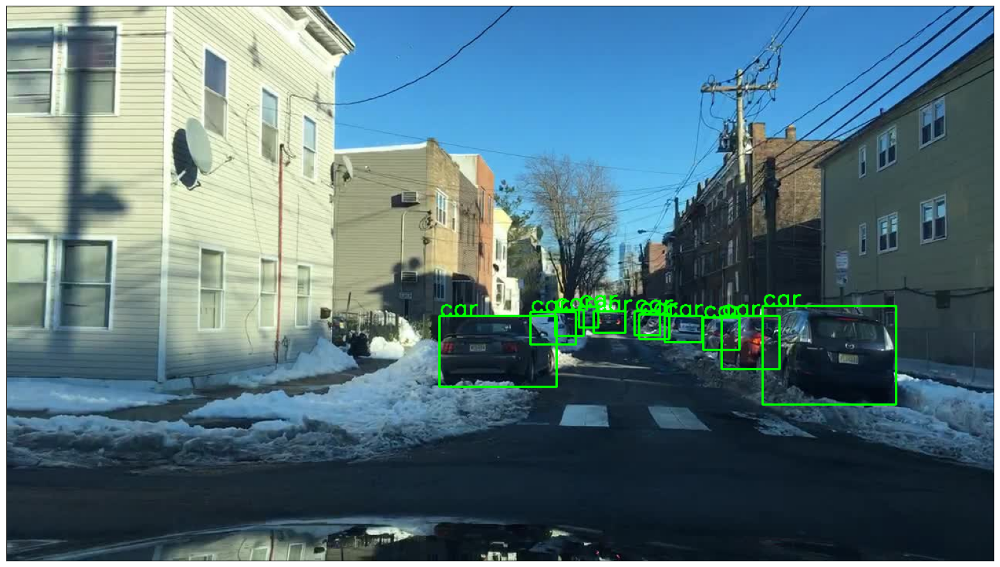

{'Model': 'Faster-RCNN', 'Image': '2.jpg', 'Predicted Classes': {'car': 11, 'truck': 1}, 'Number of Objects': 12}


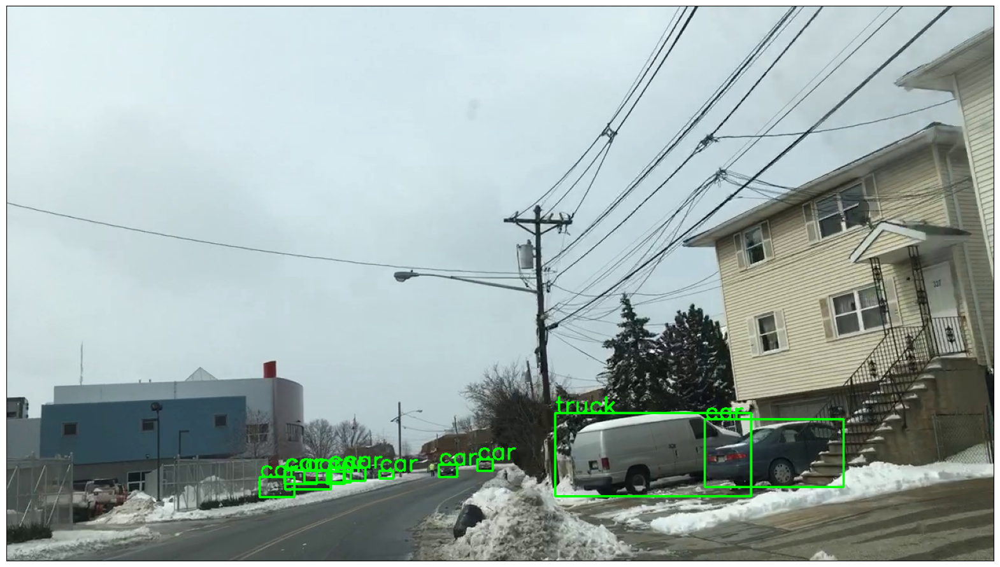

{'Model': 'Faster-RCNN', 'Image': '3.jpg', 'Predicted Classes': {'car': 5}, 'Number of Objects': 5}


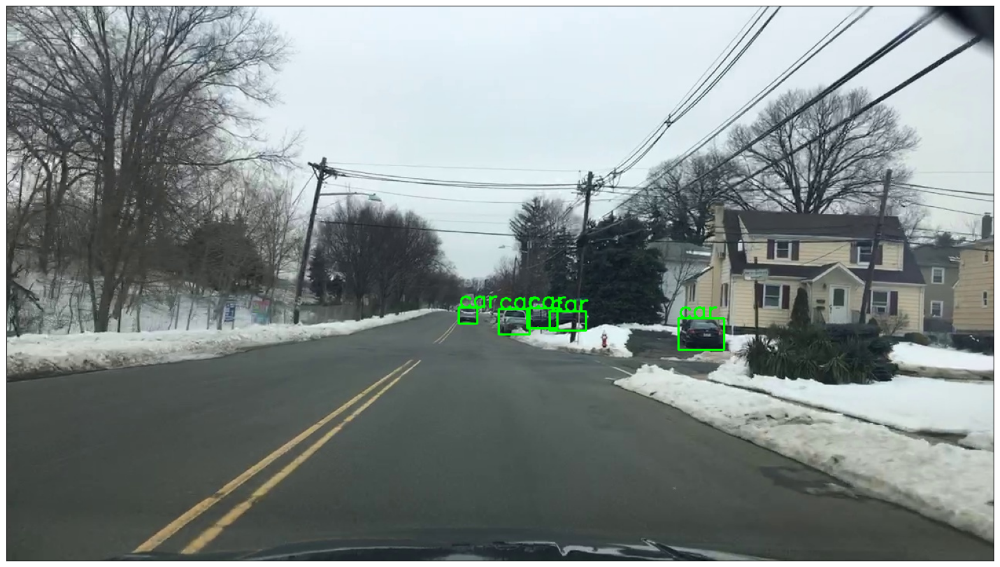

{'Model': 'Faster-RCNN', 'Image': '4.jpg', 'Predicted Classes': {'car': 11}, 'Number of Objects': 11}


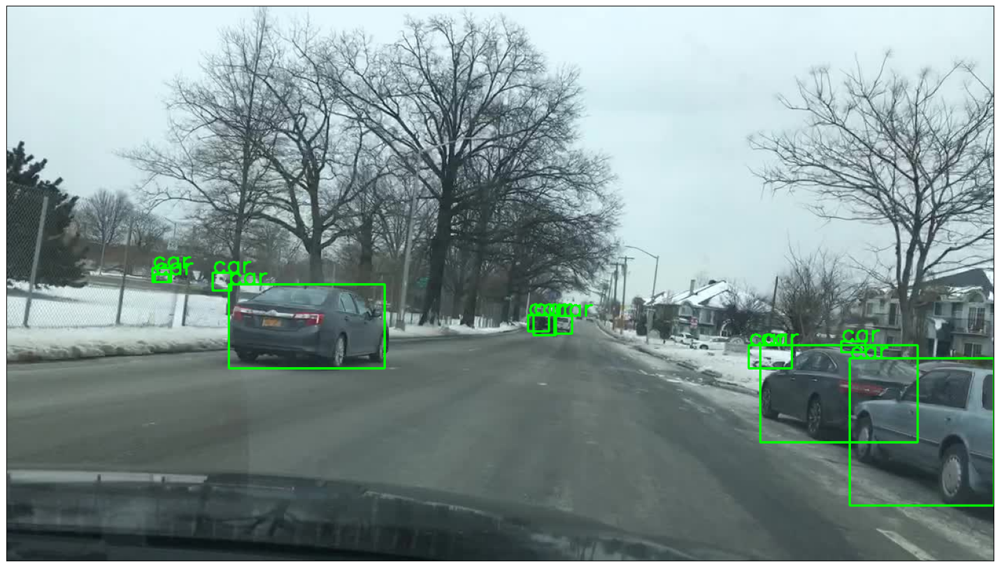

{'Model': 'Faster-RCNN', 'Image': '5.jpg', 'Predicted Classes': {'car': 12, 'truck': 1, 'traffic light': 3}, 'Number of Objects': 16}


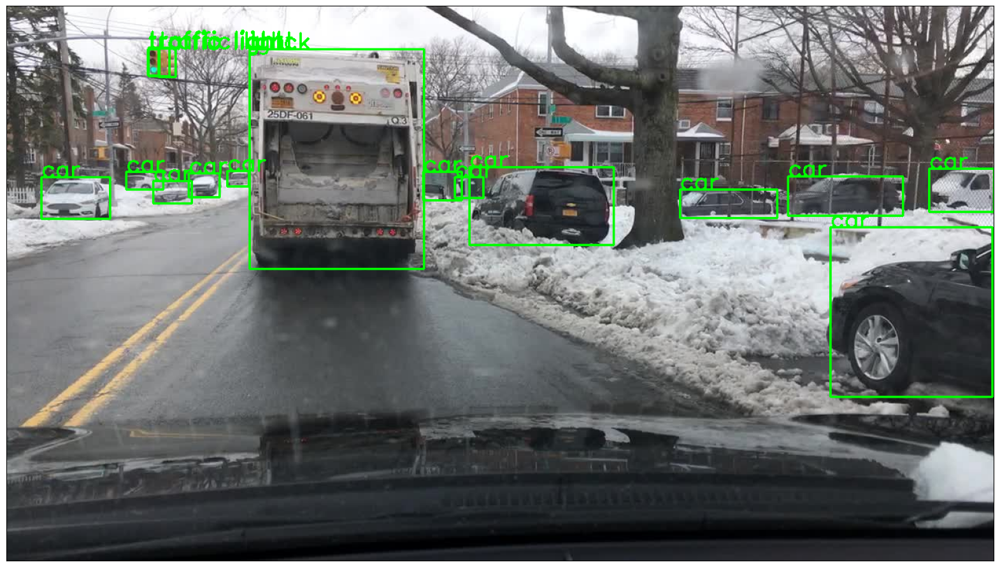

{'Model': 'Faster-RCNN', 'Image': '6.jpg', 'Predicted Classes': {'car': 8, 'stop sign': 1}, 'Number of Objects': 9}


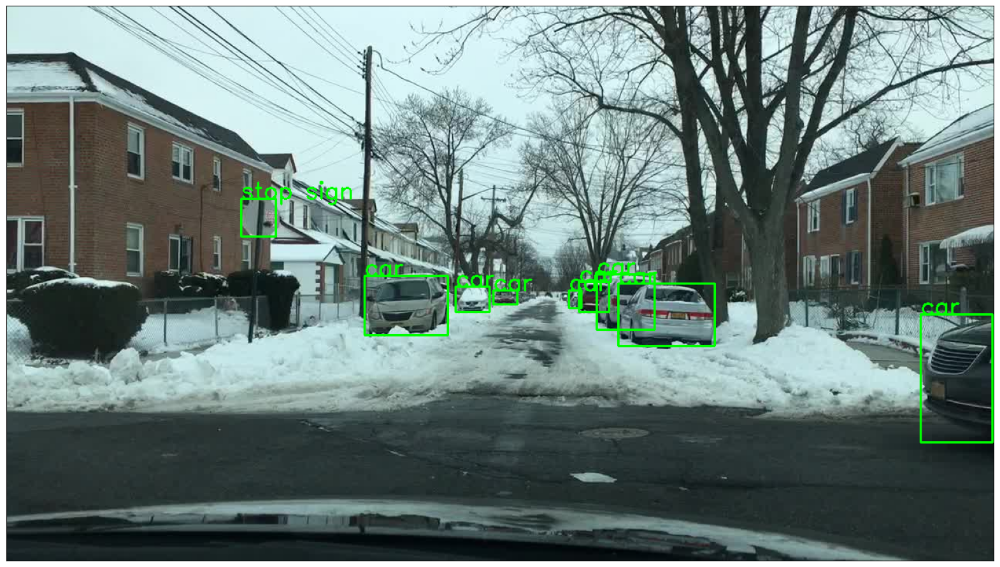

{'Model': 'Faster-RCNN', 'Image': '7.jpg', 'Predicted Classes': {'car': 3}, 'Number of Objects': 3}


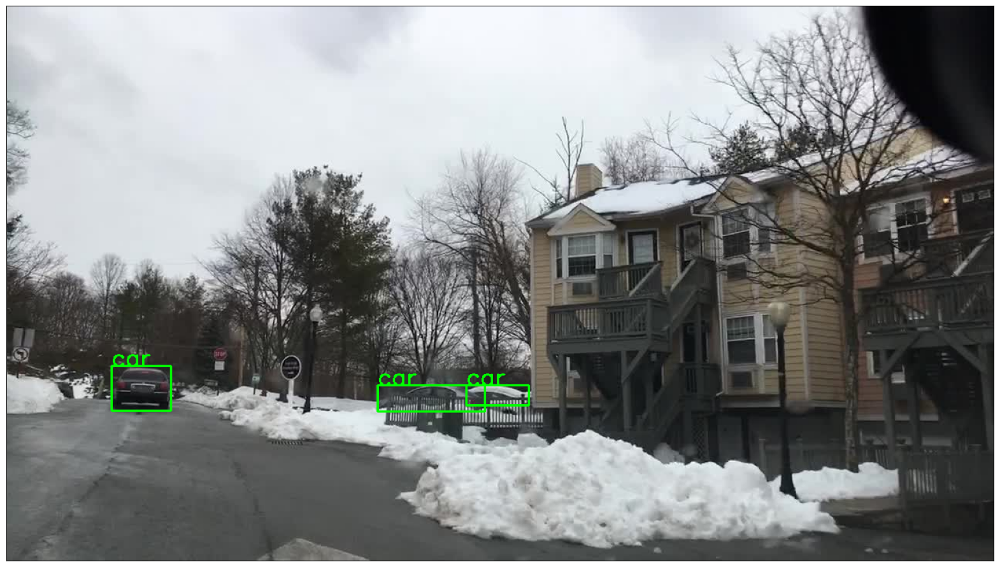

{'Model': 'Faster-RCNN', 'Image': '8.jpg', 'Predicted Classes': {'stop sign': 1, 'car': 2}, 'Number of Objects': 3}


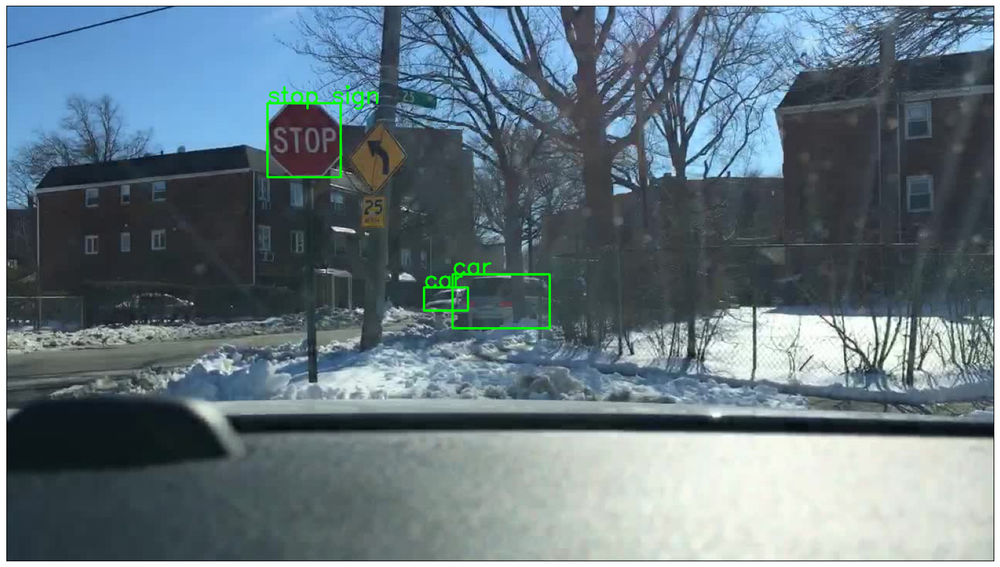

{'Model': 'Faster-RCNN', 'Image': '9.jpg', 'Predicted Classes': {'person': 8, 'car': 7, 'traffic light': 3, 'truck': 2, 'suitcase': 1}, 'Number of Objects': 21}


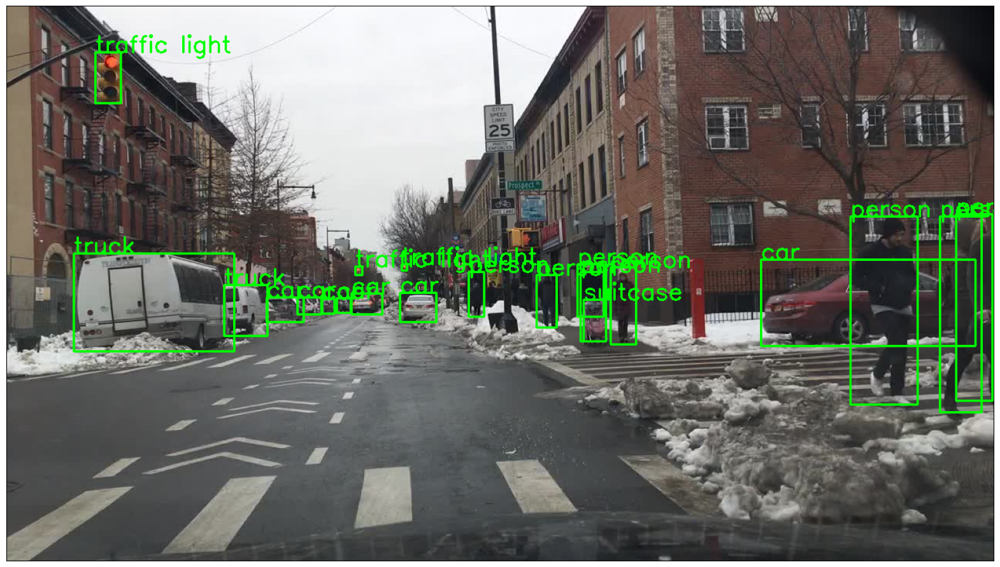

{'Model': 'Faster-RCNN', 'Image': '10.jpg', 'Predicted Classes': {'traffic light': 5, 'car': 15, 'truck': 1}, 'Number of Objects': 21}


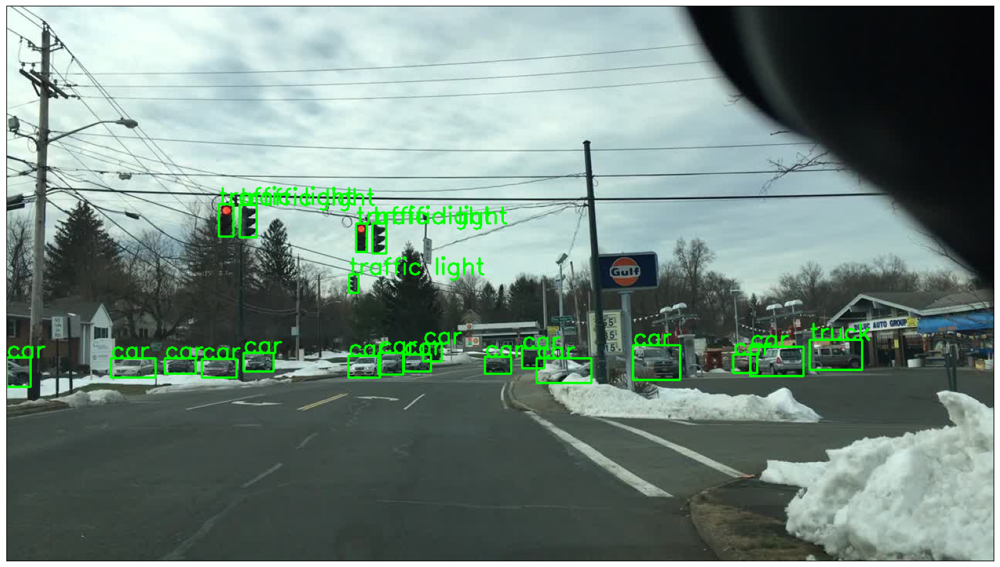

{'Model': 'Faster-RCNN', 'Image': '11.jpg', 'Predicted Classes': {'car': 9}, 'Number of Objects': 9}


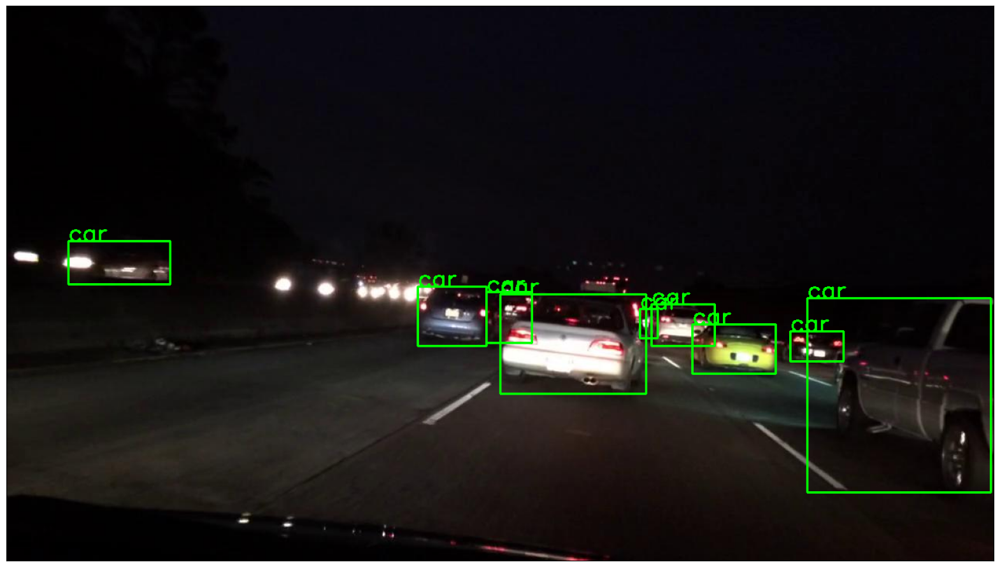

{'Model': 'Faster-RCNN', 'Image': '12.jpg', 'Predicted Classes': {'car': 16, 'traffic light': 2, 'bus': 1}, 'Number of Objects': 19}


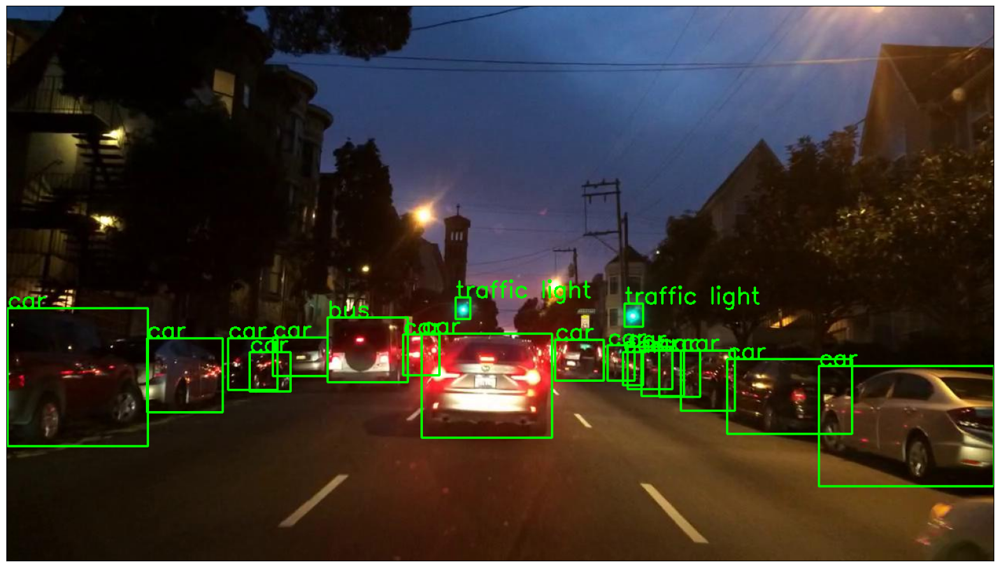

{'Model': 'Faster-RCNN', 'Image': '13.jpg', 'Predicted Classes': {'car': 5, 'traffic light': 4}, 'Number of Objects': 9}


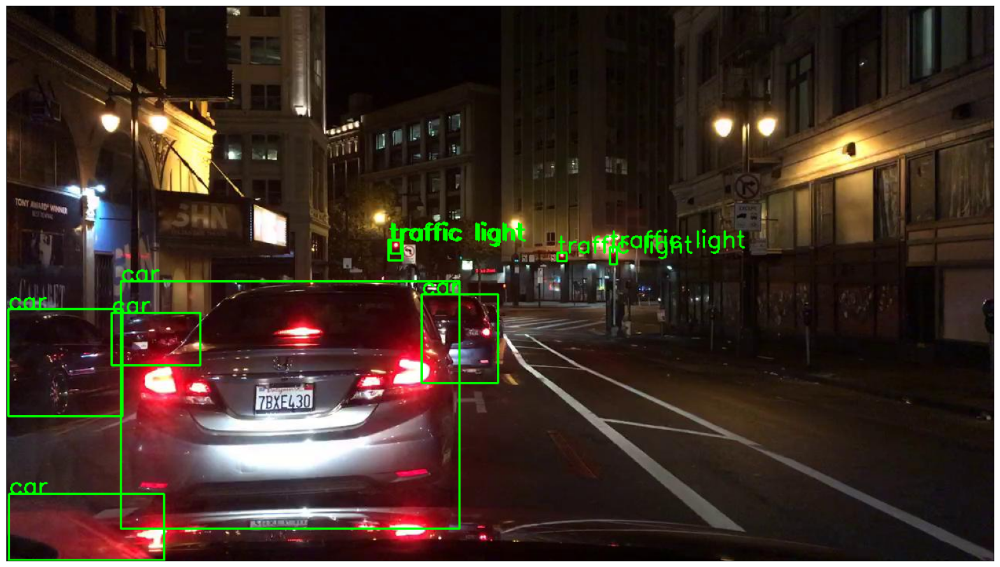

{'Model': 'Faster-RCNN', 'Image': '14.jpg', 'Predicted Classes': {'car': 8}, 'Number of Objects': 8}


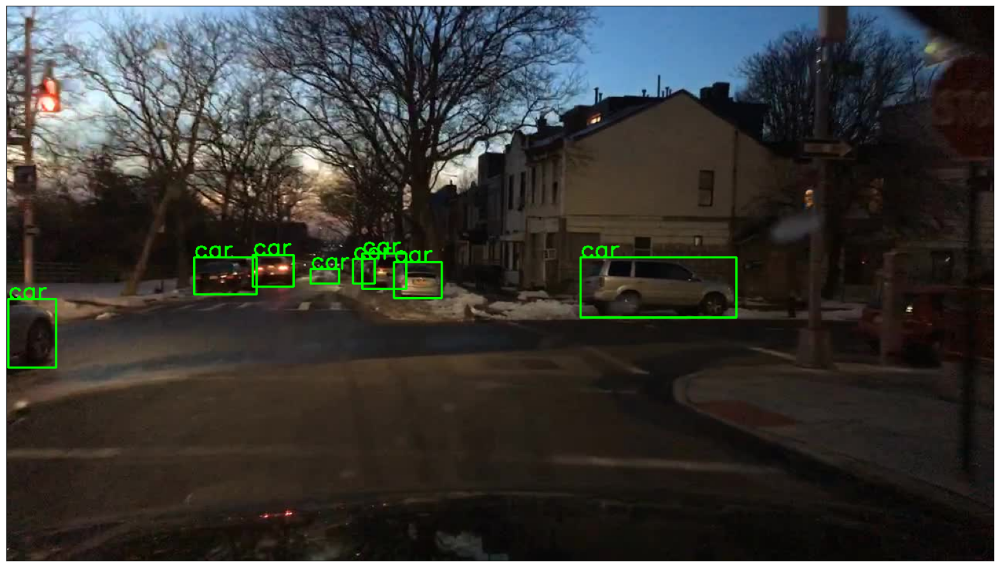

{'Model': 'Faster-RCNN', 'Image': '15.jpg', 'Predicted Classes': {'stop sign': 1, 'car': 20, 'person': 1}, 'Number of Objects': 22}


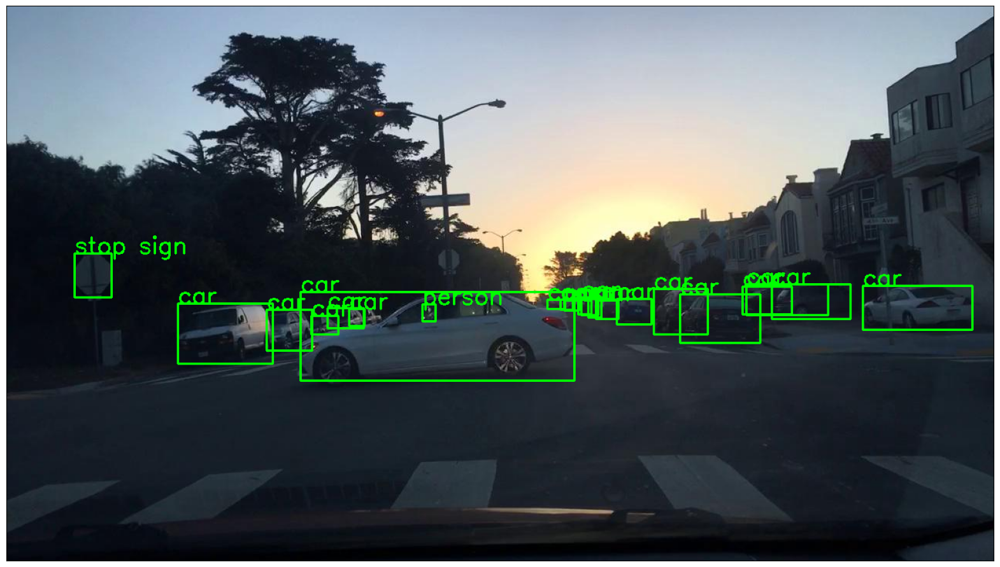

{'Model': 'Faster-RCNN', 'Image': '16.jpg', 'Predicted Classes': {'car': 6, 'traffic light': 6, 'person': 1}, 'Number of Objects': 13}


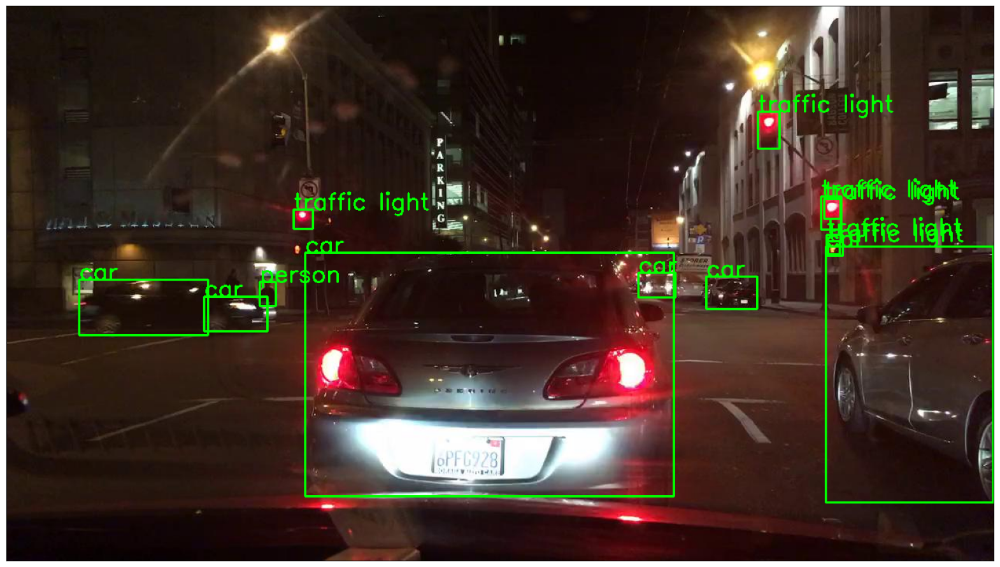

{'Model': 'Faster-RCNN', 'Image': '17.jpg', 'Predicted Classes': {'car': 4, 'traffic light': 3, 'fire hydrant': 1, 'person': 1}, 'Number of Objects': 9}


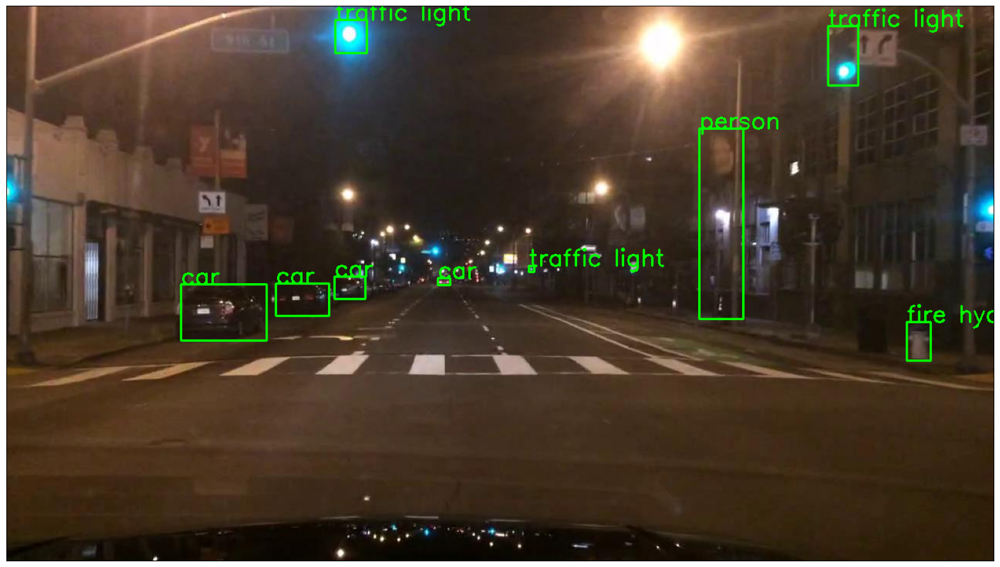

{'Model': 'Faster-RCNN', 'Image': '18.jpg', 'Predicted Classes': {'car': 7, 'truck': 1, 'traffic light': 3}, 'Number of Objects': 11}


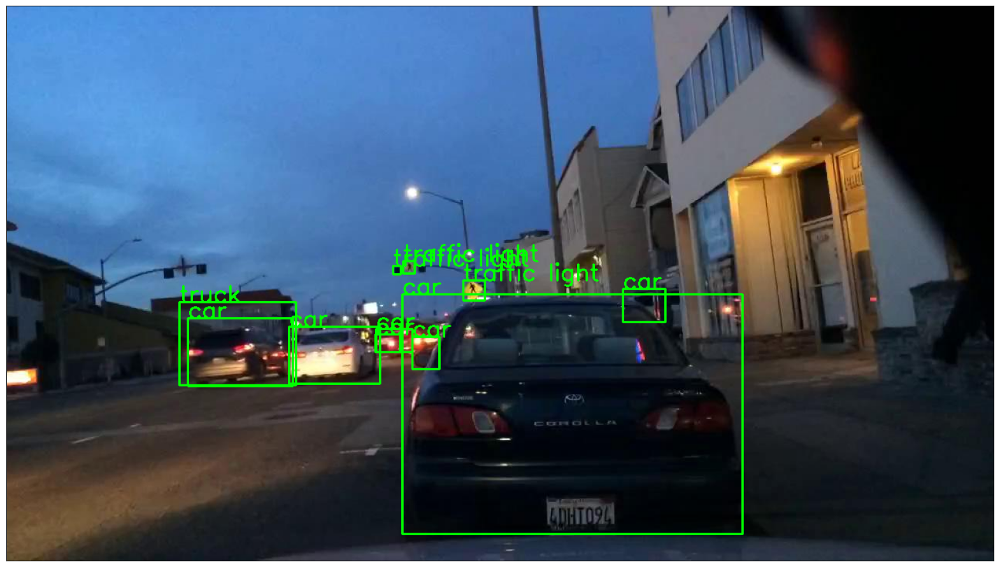

{'Model': 'Faster-RCNN', 'Image': '19.jpg', 'Predicted Classes': {'car': 10, 'tv': 2, 'traffic light': 4, 'person': 1}, 'Number of Objects': 17}


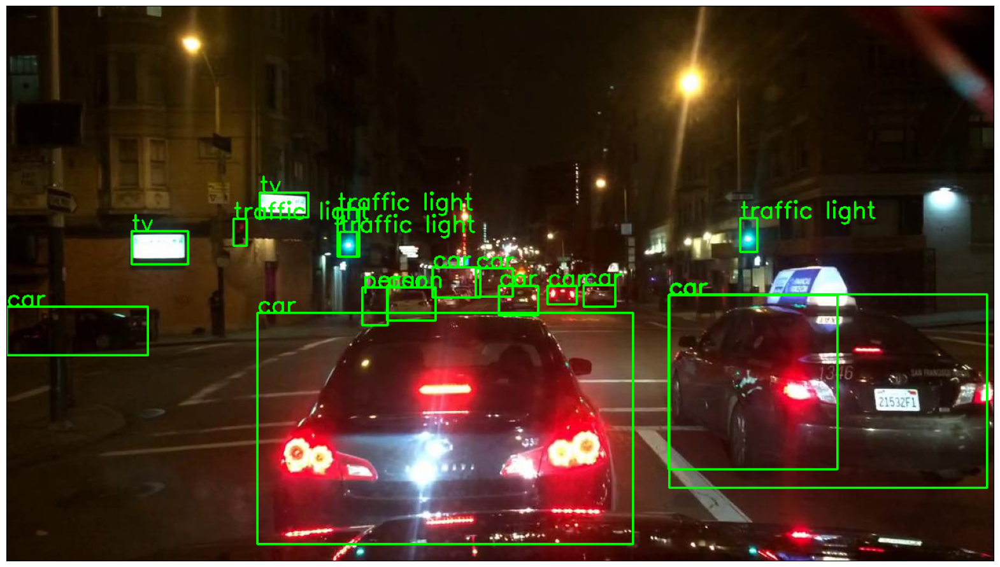

{'Model': 'Faster-RCNN', 'Image': '20.jpg', 'Predicted Classes': {'car': 10, 'bus': 1, 'traffic light': 1}, 'Number of Objects': 12}


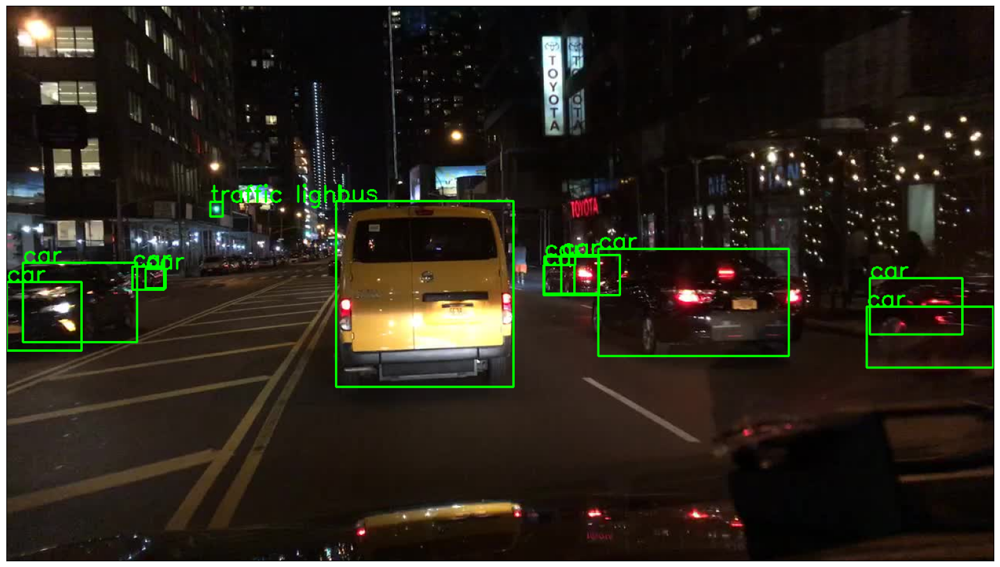

{'Model': 'Faster-RCNN', 'Image': '21.jpg', 'Predicted Classes': {'car': 16, 'truck': 1}, 'Number of Objects': 17}


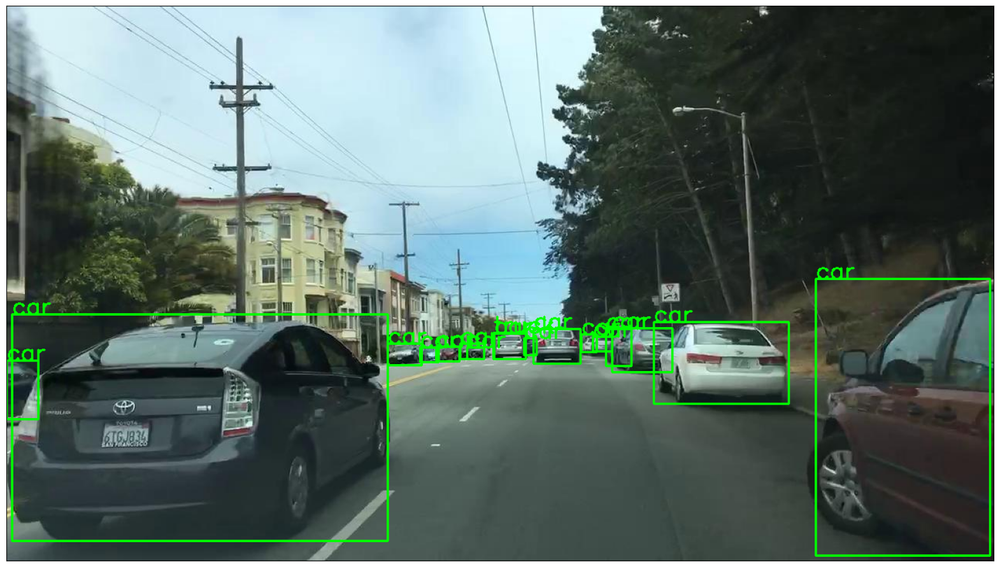

{'Model': 'Faster-RCNN', 'Image': '22.jpg', 'Predicted Classes': {'car': 10, 'traffic light': 3, 'fire hydrant': 1, 'person': 1}, 'Number of Objects': 15}


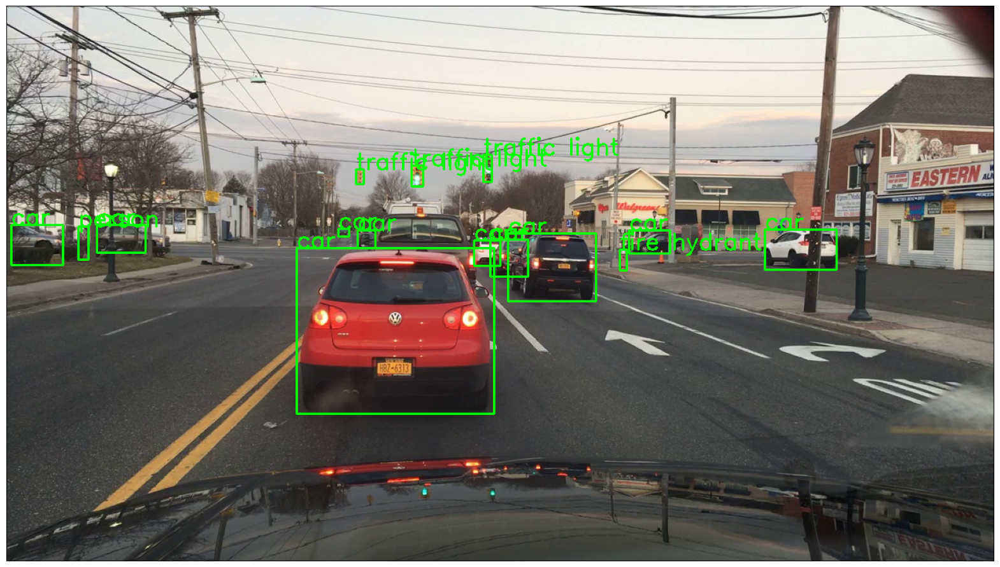

{'Model': 'Faster-RCNN', 'Image': '23.jpg', 'Predicted Classes': {'car': 13, 'person': 10, 'bicycle': 1, 'bus': 2, 'handbag': 1}, 'Number of Objects': 27}


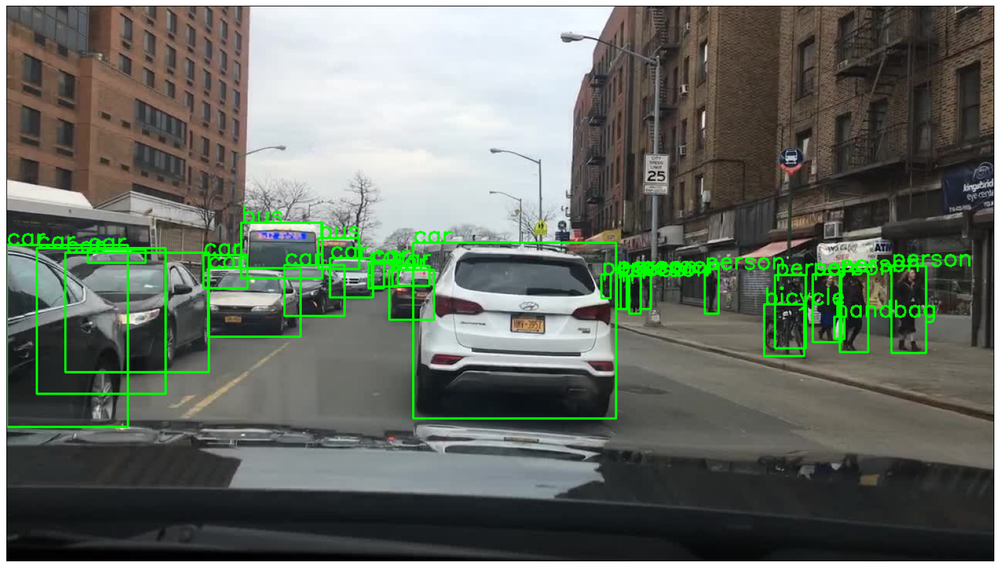

{'Model': 'Faster-RCNN', 'Image': '24.jpg', 'Predicted Classes': {'car': 12, 'traffic light': 7, 'truck': 2}, 'Number of Objects': 21}


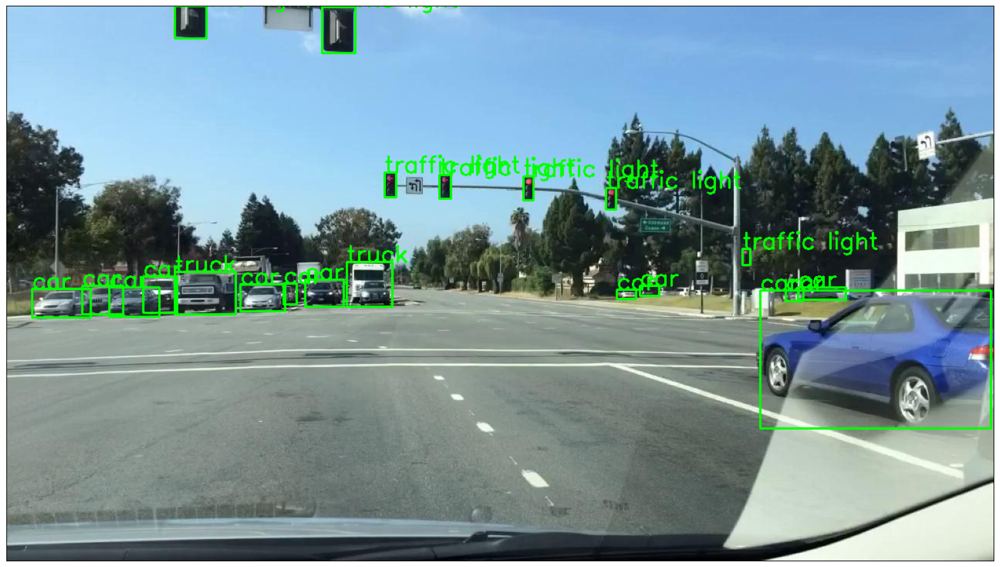

{'Model': 'Faster-RCNN', 'Image': '25.jpg', 'Predicted Classes': {'person': 5, 'car': 11, 'traffic light': 1, 'handbag': 2}, 'Number of Objects': 19}


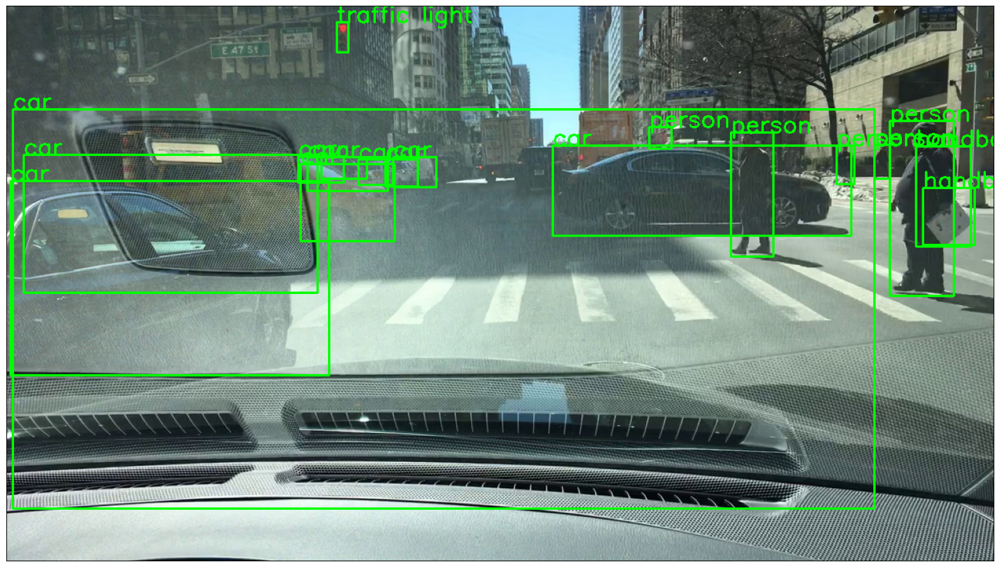

{'Model': 'Faster-RCNN', 'Image': '26.jpg', 'Predicted Classes': {'car': 8, 'traffic light': 5}, 'Number of Objects': 13}


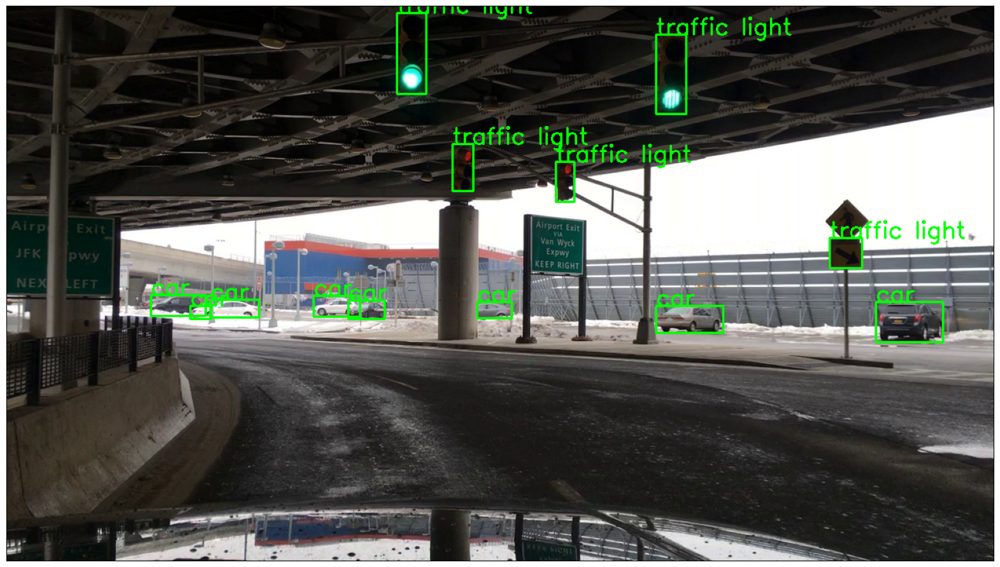

{'Model': 'Faster-RCNN', 'Image': '27.jpg', 'Predicted Classes': {'car': 14}, 'Number of Objects': 14}


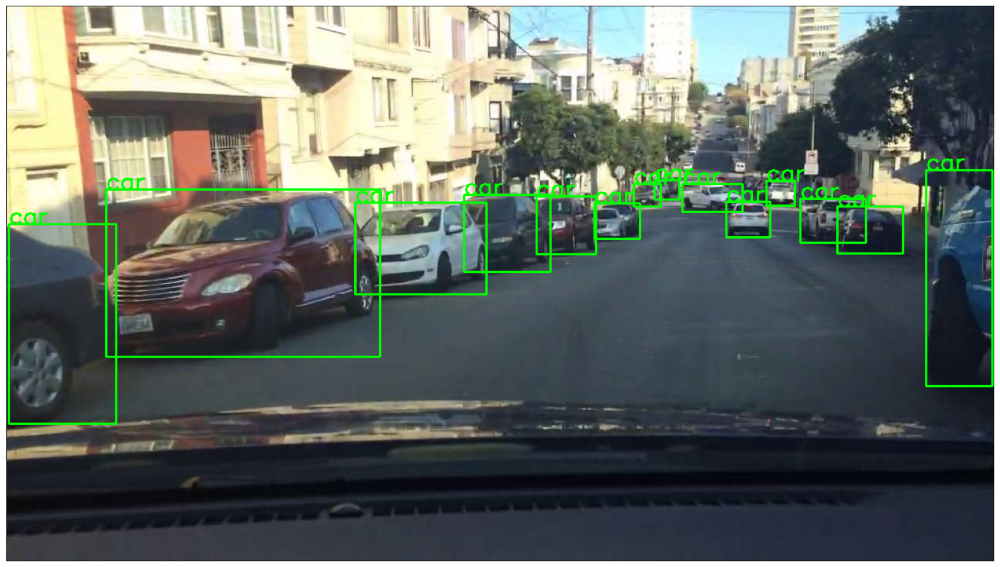

{'Model': 'Faster-RCNN', 'Image': '28.jpg', 'Predicted Classes': {'car': 14, 'traffic light': 5, 'person': 1, 'truck': 1}, 'Number of Objects': 21}


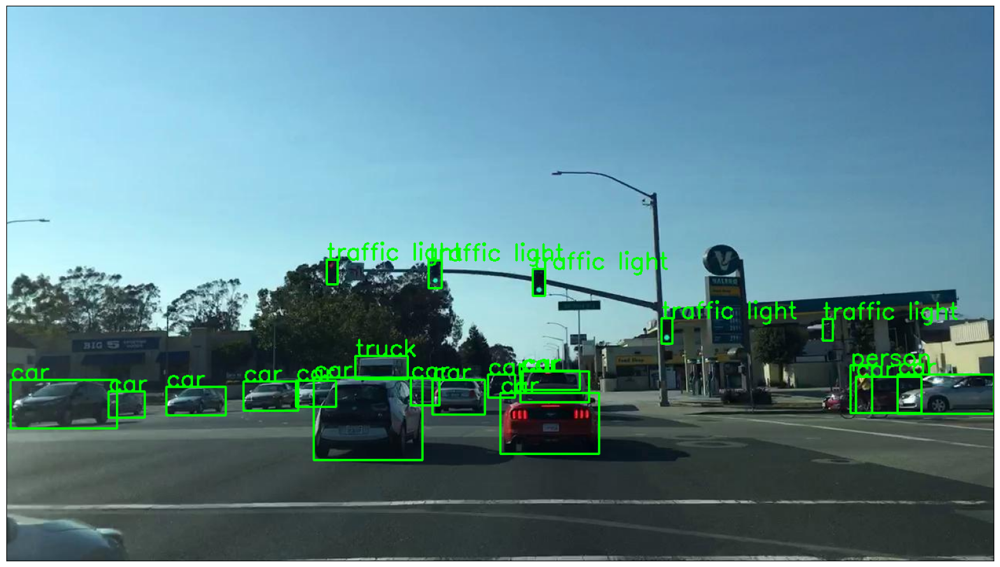

{'Model': 'Faster-RCNN', 'Image': '29.jpg', 'Predicted Classes': {'car': 14, 'person': 4, 'traffic light': 1}, 'Number of Objects': 19}


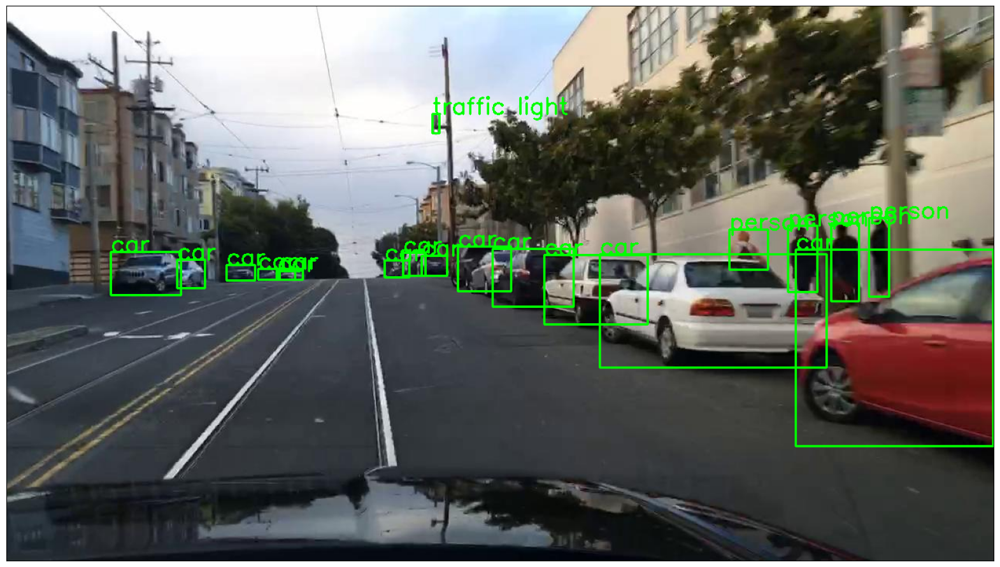

{'Model': 'Faster-RCNN', 'Image': '30.jpg', 'Predicted Classes': {'truck': 3, 'person': 5, 'car': 3, 'traffic light': 5}, 'Number of Objects': 16}


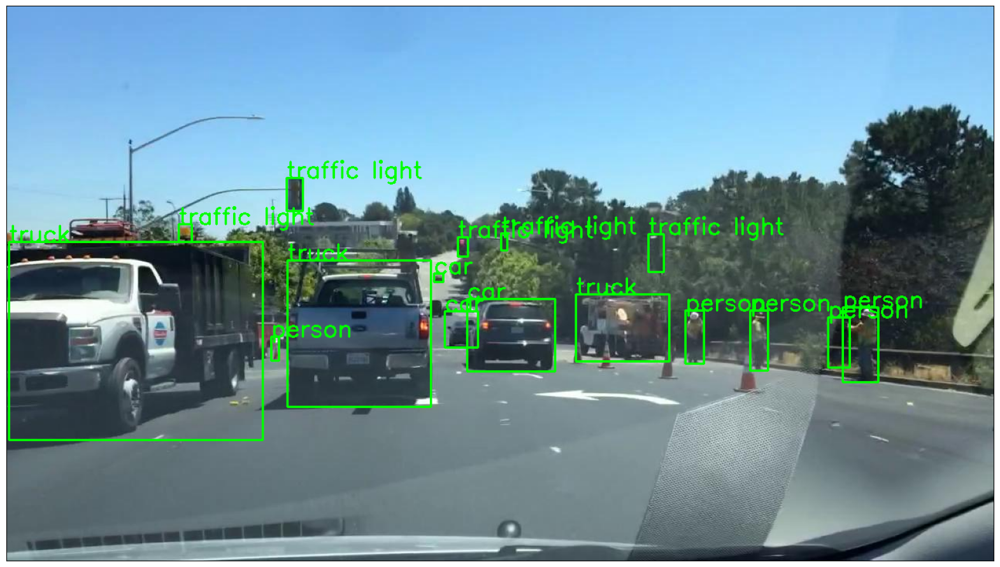

{'Model': 'Faster-RCNN', 'Image': '31.jpg', 'Predicted Classes': {'car': 7, 'kite': 1}, 'Number of Objects': 8}


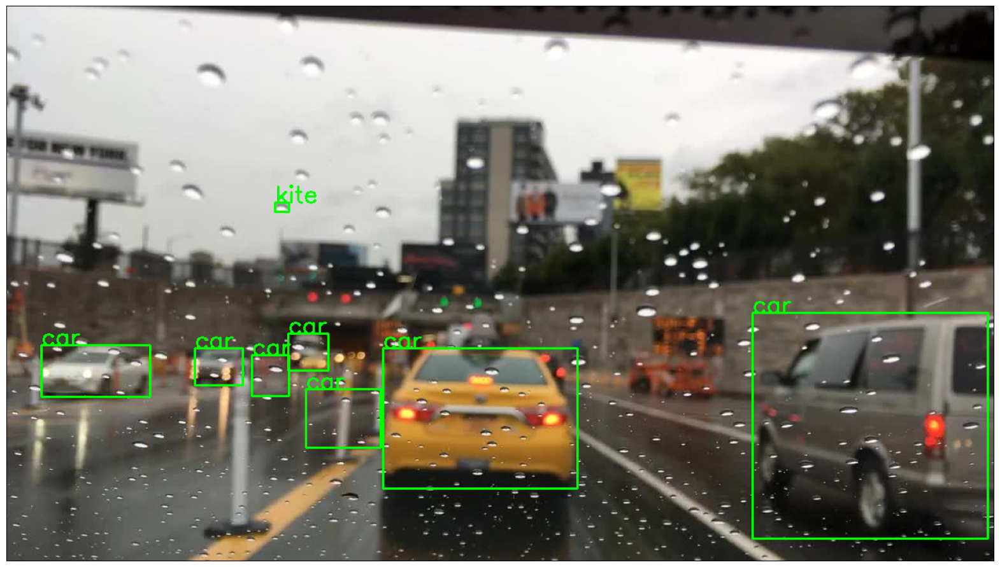

{'Model': 'Faster-RCNN', 'Image': '32.jpg', 'Predicted Classes': {'truck': 2, 'car': 9, 'person': 2, 'motorcycle': 1}, 'Number of Objects': 14}


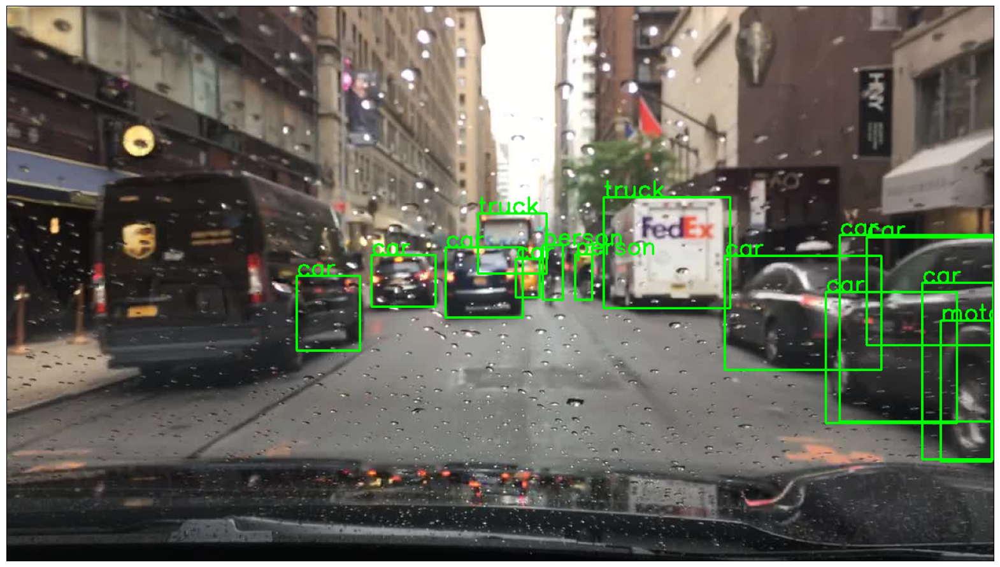

In [14]:
for i in range(1,33):
  detect_object(f'./TestPhoto/{i}.jpg', output_frcnn, confidence=0.6)

In [ ]:
df = pd.DataFrame(results)
df['Image_numeric'] = df['Image'].str.extract('(\d+)').astype(float)
df = df.sort_values(by='Image_numeric', ascending=True).reset_index(drop=True)
df = df.drop('Image_numeric', axis=1)

df.to_csv(f'{output_frcnn}/models_info.csv', index=False)

In [ ]:
def check_inference_time(image_path, gpu=False):
  model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=True)
  model.eval()
  img = Image.open(image_path)
  transform = T.Compose([T.ToTensor()])
  img = transform(img)
  if gpu:
    model.cuda()
    img = img.cuda()
  else:
    model.cpu()
    img = img.cpu()
  start_time = time.time()
  pred = model([img])
  end_time = time.time()
  return end_time-start_time

In [ ]:
gpu_time = sum([check_inference_time(f'./TestPhoto/{i}.jpg', gpu=True) for i in range(1, 11)])/10.0
cpu_time = sum([check_inference_time(f'./TestPhoto/{i}.jpg', gpu=False) for i in range(1, 11)])/10.0

print('\n\nAverage Time take by the model with GPU = {}s\nAverage Time take by the model with CPU = {}s'.format(gpu_time,cpu_time))



Average Time take by the model with GPU = 0.12111990451812744s
Average Time take by the model with CPU = 6.160308289527893s


In [ ]:
data = {'Model': ['Faster-RCNN'], 'Inference_Time_GPU': [gpu_time], 'Inference_Time_CPU': [cpu_time]}

In [ ]:
df_time = pd.DataFrame(data)
df_time.to_csv(f'{output_frcnn}/models_time.csv', index=False)

In [ ]:
df_time

,Model,Inference_Time_GPU,Inference_Time_CPU
0,Faster-RCNN,0.12112,6.160308
